Your FIFA project goes here:

[18:07] Ines Campos Gamez
#### Lista de cambios a hacer
1. Arreglar aquellas columnas con sumas y estrellas
2. Eliminar las unidades de medida en: altura y peso
3. Cambiar los Nuns por la media
4. Eliminar los valores duplicados

#### General analysis and cleanup of columns

In [1]:
import pandas as pd
import numpy as np
pd.set_option('display.max_columns', None)
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
import seaborn as sns 
%matplotlib inline

In [2]:
data = pd.read_csv("./file_for_project/fifa21_training.csv")
data.head(3)

,Unnamed: 0,ID,Name,Age,Nationality,Club,BP,Position,Team & Contract,Height,Weight,foot,Growth,Joined,Loan Date End,Value,Wage,Release Clause,Contract,Attacking,Crossing,Finishing,Heading Accuracy,Short Passing,Volleys,Skill,Dribbling,Curve,FK Accuracy,Long Passing,Ball Control,Movement,Acceleration,Sprint Speed,Agility,Reactions,Balance,Power,Shot Power,Jumping,Stamina,Strength,Long Shots,Mentality,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Defending,Marking,Standing Tackle,Sliding Tackle,Goalkeeping,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes,Total Stats,Base Stats,W/F,SM,A/W,D/W,IR,PAC,SHO,PAS,DRI,DEF,PHY,Hits,LS,ST,RS,LW,LF,CF,RF,RW,LAM,CAM,RAM,LM,LCM,CM,RCM,RM,LWB,LDM,CDM,RDM,RWB,LB,LCB,CB,RCB,RB,GK,OVA
0,1954,184383,A. Pasche,26,Switzerland,FC Lausanne-Sport,CM,CM CDM,FC Lausanne-Sport 2015 ~ 2020,"5'9""",161lbs,Right,1,"Jul 1, 2015",NaN,€525K,€4K,€801K,2015 ~ 2020,258,54,47,43,70,44.0,286,61,44.0,55,63,63,346,64,73,61.0,66,82.0,306,62,73.0,71,55,45,290,54,52.0,62.0,68.0,54,54.0,148,49,56,43.0,48,7,12,14,9,6,1682,357,4 ★,2★,High,Medium,1 ★,69,51,63,63,51,60,3,58+1,58+1,58+1,61+0,62+0,62+0,62+0,61+0,63+1,63+1,63+1,63+1,63+1,63+1,63+1,63+1,59+1,59+1,59+1,59+1,59+1,58+1,54+1,54+1,54+1,58+1,15+1,64
1,2225,188044,Alan Carvalho,30,China PR,Beijing Sinobo Guoan FC,ST,ST LW LM,"Beijing Sinobo Guoan FC Dec 31, 2020 On Loan","6'0""",159lbs,Right,0,"Jan 16, 2015","Dec 31, 2020",€8.5M,€23K,€0,"Dec 31, 2020 On Loan",365,66,79,76,68,76.0,375,83,78.0,72,63,79,404,83,83,88.0,75,75.0,372,74,81.0,75,74,68,313,54,33.0,78.0,72.0,76,70.0,77,35,20,22.0,55,11,7,14,7,16,1961,412,3 ★,4★,High,Low,2 ★,83,75,68,82,33,71,44,77+0,77+0,77+0,77+0,77+0,77+0,77+0,77+0,76+1,76+1,76+1,76+1,68+2,68+2,68+2,76+1,57+2,53+2,53+2,53+2,57+2,53+2,48+2,48+2,48+2,53+2,18+2,77
2,1959,184431,S. Giovinco,33,Italy,Al Hilal,CAM,CAM CF,Al Hilal 2019 ~ 2022,"5'4""",134lbs,Right,0,"Jan 31, 2019",NaN,€9M,€49K,€15.3M,2019 ~ 2022,336,73,76,34,78,75.0,424,85,89.0,91,74,85,424,84,76,93.0,78,93.0,308,79,34.0,75,42,78,332,75,26.0,80.0,78.0,73,82.0,80,23,29,28.0,21,6,3,6,3,3,1925,404,4 ★,4★,High,Medium,2 ★,80,77,78,86,27,56,73,73+2,73+2,73+2,80+0,79+0,79+0,79+0,80+0,80+0,80+0,80+0,79+1,74+2,74+2,74+2,79+1,59+2,56+2,56+2,56+2,59+2,53+2,41+2,41+2,41+2,53+2,12+2,80


In [3]:
data.shape

(13700, 102)

In [4]:
list(data.columns)

['Unnamed: 0',
 'ID',
 'Name',
 'Age',
 'Nationality',
 'Club',
 'BP',
 'Position',
 'Team & Contract',
 'Height',
 'Weight',
 'foot',
 'Growth',
 'Joined',
 'Loan Date End',
 'Value',
 'Wage',
 'Release Clause',
 'Contract',
 'Attacking',
 'Crossing',
 'Finishing',
 'Heading Accuracy',
 'Short Passing',
 'Volleys',
 'Skill',
 'Dribbling',
 'Curve',
 'FK Accuracy',
 'Long Passing',
 'Ball Control',
 'Movement',
 'Acceleration',
 'Sprint Speed',
 'Agility',
 'Reactions',
 'Balance',
 'Power',
 'Shot Power',
 'Jumping',
 'Stamina',
 'Strength',
 'Long Shots',
 'Mentality',
 'Aggression',
 'Interceptions',
 'Positioning',
 'Vision',
 'Penalties',
 'Composure',
 'Defending',
 'Marking',
 'Standing Tackle',
 'Sliding Tackle',
 'Goalkeeping',
 'GK Diving',
 'GK Handling',
 'GK Kicking',
 'GK Positioning',
 'GK Reflexes',
 'Total Stats',
 'Base Stats',
 'W/F',
 'SM',
 'A/W',
 'D/W',
 'IR',
 'PAC',
 'SHO',
 'PAS',
 'DRI',
 'DEF',
 'PHY',
 'Hits',
 'LS',
 'ST',
 'RS',
 'LW',
 'LF',
 'CF',
 'RF'

In [5]:
data.columns=[e.lower().replace(' ', '_') for e in data.columns]
list(data)

['unnamed:_0',
 'id',
 'name',
 'age',
 'nationality',
 'club',
 'bp',
 'position',
 'team_&_contract',
 'height',
 'weight',
 'foot',
 'growth',
 'joined',
 'loan_date_end',
 'value',
 'wage',
 'release_clause',
 'contract',
 'attacking',
 'crossing',
 'finishing',
 'heading_accuracy',
 'short_passing',
 'volleys',
 'skill',
 'dribbling',
 'curve',
 'fk_accuracy',
 'long_passing',
 'ball_control',
 'movement',
 'acceleration',
 'sprint_speed',
 'agility',
 'reactions',
 'balance',
 'power',
 'shot_power',
 'jumping',
 'stamina',
 'strength',
 'long_shots',
 'mentality',
 'aggression',
 'interceptions',
 'positioning',
 'vision',
 'penalties',
 'composure',
 'defending',
 'marking',
 'standing_tackle',
 'sliding_tackle',
 'goalkeeping',
 'gk_diving',
 'gk_handling',
 'gk_kicking',
 'gk_positioning',
 'gk_reflexes',
 'total_stats',
 'base_stats',
 'w/f',
 'sm',
 'a/w',
 'd/w',
 'ir',
 'pac',
 'sho',
 'pas',
 'dri',
 'def',
 'phy',
 'hits',
 'ls',
 'st',
 'rs',
 'lw',
 'lf',
 'cf',
 'rf'

#### NaNs

<font color='red'>
Hemos sustituido NaNs por la moda en vez de la media (por categóricos)
<font>

In [10]:
pd.set_option("display.max_rows", None)

In [11]:
round(data.isna().sum()/len(data),4)*100

unnamed:_0           0.00
id                   0.00
name                 0.00
age                  0.00
nationality          0.00
club                 0.15
bp                   0.00
position             2.50
team_&_contract      0.00
height               0.00
weight               0.00
foot                 0.00
growth               0.00
joined               0.32
loan_date_end       94.61
value                0.00
wage                 0.00
release_clause       0.00
contract             0.00
attacking            0.00
crossing             0.00
finishing            0.00
heading_accuracy     0.00
short_passing        0.00
volleys              0.32
skill                0.00
dribbling            0.00
curve                0.32
fk_accuracy          0.00
long_passing         0.00
ball_control         0.00
movement             0.00
acceleration         0.00
sprint_speed         0.00
agility              0.32
reactions            0.00
balance              0.32
power                0.00
shot_power  

In [34]:
data.drop('loan_date_end', axis=1, inplace=True)

In [35]:
col_muchoNaN = ('club', 'position', 'joined', 'volleys', 'curve', 'agility', 'balance', 'jumping', 'vision', 'composture', 'sliding_tackle', 'a/w', 'd/w')

In [36]:
data.head(20)

,unnamed:_0,id,name,age,nationality,club,bp,position,team_&_contract,height,weight,foot,growth,joined,value,wage,release_clause,contract,attacking,crossing,finishing,heading_accuracy,short_passing,volleys,skill,dribbling,curve,fk_accuracy,long_passing,ball_control,movement,acceleration,sprint_speed,agility,reactions,balance,power,shot_power,jumping,stamina,strength,long_shots,mentality,aggression,interceptions,positioning,vision,penalties,composure,defending,marking,standing_tackle,sliding_tackle,goalkeeping,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes,total_stats,base_stats,a/w,d/w,pac,sho,pas,dri,def,phy,hits,ova,ls,ls1,st,st1,rs,rs1,lw,lw1,lf,lf1,cf,cf1,rf,rf1,rw,rw1,lam,lam1,cam,cam1,ram,ram1,lm,lm1,lcm,lcm1,cm,cm1,rcm,rcm1,rm,rm1,lwb,lwb1,ldm,ldm1,cdm,cdm1,rdm,rdm1,rwb,rwb1,lb,lb1,lcb,lcb1,cb,cb1,rcb,rcb1,rb,rb1,gk,gk1,w/f,sm,ir
0,1954,184383,A. Pasche,26,Switzerland,FC Lausanne-Sport,CM,CM CDM,FC Lausanne-Sport 2015 ~ 2020,69.0,161,Right,1,"Jul 1, 2015",€525K,€4K,€801K,2015 ~ 2020,258,54,47,43,70,44.0,286,61,44.0,55,63,63,346,64,73,61.0,66,82.0,306,62,73.0,71,55,45,290,54,52.0,62.0,68.0,54,54.0,148,49,56,43.0,48,7,12,14,9,6,1682,357,High,Medium,69,51,63,63,51,60,3,64,58,1,58,1,58,1,61,0,62,0,62,0,62,0,61,0,63,1,63,1,63,1,63,1,63,1,63,1,63,1,63,1,59,1,59,1,59,1,59,1,59,1,58,1,54,1,54,1,54,1,58,1,15,1,4,2,1
1,2225,188044,Alan Carvalho,30,China PR,Beijing Sinobo Guoan FC,ST,ST LW LM,"Beijing Sinobo Guoan FC Dec 31, 2020 On Loan",72.0,159,Right,0,"Jan 16, 2015",€8.5M,€23K,€0,"Dec 31, 2020 On Loan",365,66,79,76,68,76.0,375,83,78.0,72,63,79,404,83,83,88.0,75,75.0,372,74,81.0,75,74,68,313,54,33.0,78.0,72.0,76,70.0,77,35,20,22.0,55,11,7,14,7,16,1961,412,High,Low,83,75,68,82,33,71,44,77,77,0,77,0,77,0,77,0,77,0,77,0,77,0,77,0,76,1,76,1,76,1,76,1,68,2,68,2,68,2,76,1,57,2,53,2,53,2,53,2,57,2,53,2,48,2,48,2,48,2,53,2,18,2,3,4,2
2,1959,184431,S. Giovinco,33,Italy,Al Hilal,CAM,CAM CF,Al Hilal 2019 ~ 2022,64.0,134,Right,0,"Jan 31, 2019",€9M,€49K,€15.3M,2019 ~ 2022,336,73,76,34,78,75.0,424,85,89.0,91,74,85,424,84,76,93.0,78,93.0,308,79,34.0,75,42,78,332,75,26.0,80.0,78.0,73,82.0,80,23,29,28.0,21,6,3,6,3,3,1925,404,High,Medium,80,77,78,86,27,56,73,80,73,2,73,2,73,2,80,0,79,0,79,0,79,0,80,0,80,0,80,0,80,0,79,1,74,2,74,2,74,2,79,1,59,2,56,2,56,2,56,2,59,2,53,2,41,2,41,2,41,2,53,2,12,2,4,4,2
3,9815,233796,J. Evans,22,Wales,Swansea City,CDM,CDM CM,Swansea City 2016 ~ 2021,70.0,152,Right,13,"Jul 1, 2016",€275K,€4K,€694K,2016 ~ 2021,242,44,42,58,62,36.0,259,54,41.0,46,57,61,282,54,59,59.0,55,55.0,277,57,60.0,64,58,38,257,61,57.0,31.0,54.0,54,48.0,168,55,58,55.0,42,8,9,6,7,12,1527,329,Medium,Medium,57,44,54,57,57,60,7,59,50,2,50,2,50,2,51,0,51,0,51,0,51,0,51,0,53,2,53,2,53,2,53,2,56,2,56,2,56,2,53,2,56,2,58,2,58,2,58,2,56,2,57,2,58,2,58,2,58,2,57,2,14,2,2,2,1
4,10074,234799,Y. Demoncy,23,France,US Orléans Loiret Football,CDM,CDM CM,US Orléans Loiret Football 2018 ~ 2021,71.0,150,Right,8,"Jul 1, 2018",€725K,€2K,€1.4M,2018 ~ 2021,249,49,37,61,68,34.0,280,64,44.0,45,61,66,324,66,66,61.0,62,69.0,280,61,34.0,81,61,43,294,66,60.0,55.0,64.0,49,58.0,185,58,61,66.0,52,8,9,15,5,15,1664,360,Low,Medium,66,44,60,64,60,66,4,65,56,2,56,2,56,2,59,0,59,0,59,0,59,0,59,0,61,2,61,2,61,2,62,2,63,2,63,2,63,2,62,2,64,2,64,2,64,2,64,2,64,2,63,2,61,2,61,2,61,2,63,2,15,2,2,3,1
5,1740,182411,Yu Hanchao,33,China PR,Shanghai Greenland Shenhua FC,LM,LM LW RW,Shanghai Greenland Shenhua FC 2020 ~ 2023,70.0,154,Right,0,"Jul 18, 2020",€1.4M,€11K,€2.2M,2020 ~ 2023,328,69,64,64,72,59.0,333,71,62.0,64,64,72,358,73,74,75.0,69,67.0,321,65,63.0,70,64,59,300,56,38.0,68.0,74.0,64,71.0,103,31,34,38.0,65,16,10,15,8,16,1808,379,High,Low,74,63,70,71,37,64,6,71,67,2,67,2,67,2,70,0,69,0,69,0,69,0,70,0,70,1,70,1,70,1,70,1,66,2,66,2,66,2,70,1,58,2,55,2,55,2,55,2,58,2,55,2,49,2,49,2,49,2,55,2,19,2,4,3,1
6,1957,184392,M. Darmian,30,Italy,Parma,RB,RB LB,Parma 2019 ~ 2023,72.0,154,Right,0,"Sep 2, 2019",€6M,€28K,€10.8M,2019 ~ 2023,325,69,55,68,74,59.0,316,72,69.0,35,66,74,361,68,67,7

#### Tipos de datos: categóricos y numéricos

In [7]:
data.dtypes

unnamed:_0      int64
id              int64
name           object
age             int64
nationality    object
                ...  
cb             object
rcb            object
rb             object
gk             object
ova             int64
Length: 102, dtype: object

In [8]:
data._get_numeric_data().columns

Index(['unnamed:_0', 'id', 'age', 'growth', 'attacking', 'crossing',
       'finishing', 'heading_accuracy', 'short_passing', 'volleys', 'skill',
       'dribbling', 'curve', 'fk_accuracy', 'long_passing', 'ball_control',
       'movement', 'acceleration', 'sprint_speed', 'agility', 'reactions',
       'balance', 'power', 'shot_power', 'jumping', 'stamina', 'strength',
       'long_shots', 'mentality', 'aggression', 'interceptions', 'positioning',
       'vision', 'penalties', 'composure', 'defending', 'marking',
       'standing_tackle', 'sliding_tackle', 'goalkeeping', 'gk_diving',
       'gk_handling', 'gk_kicking', 'gk_positioning', 'gk_reflexes',
       'total_stats', 'base_stats', 'pac', 'sho', 'pas', 'dri', 'def', 'phy',
       'ova'],
      dtype='object')

In [9]:
data.select_dtypes('object').columns

Index(['name', 'nationality', 'club', 'bp', 'position', 'team_&_contract',
       'height', 'weight', 'foot', 'joined', 'loan_date_end', 'value', 'wage',
       'release_clause', 'contract', 'w/f', 'sm', 'a/w', 'd/w', 'ir', 'hits',
       'ls', 'st', 'rs', 'lw', 'lf', 'cf', 'rf', 'rw', 'lam', 'cam', 'ram',
       'lm', 'lcm', 'cm', 'rcm', 'rm', 'lwb', 'ldm', 'cdm', 'rdm', 'rwb', 'lb',
       'lcb', 'cb', 'rcb', 'rb', 'gk'],
      dtype='object')

### Limpieza Datos

#### 1. Sumas

In [12]:
col_sumitas = ['ls', 'st', 'rs', 'lw', 'lf', 'cf', 'rf', 'rw', 'lam', 'cam', 'ram','lm', 'lcm', 'cm', 'rcm', 'rm', 'lwb', 'ldm', 'cdm', 'rdm', 'rwb', 'lb','lcb', 'cb', 'rcb', 'rb', 'gk']

In [13]:
def sep_columns(df, columns) :
    return pd.concat([df[e].str.split('[ + ]', expand=True).rename(columns={0 : e, 1: e + '1'}) for e in columns], axis=1)

In [14]:
data2 = sep_columns(data, col_sumitas)

In [15]:
data.drop(col_sumitas, axis=1, inplace=True)

In [16]:
data = pd.concat([data, data2], axis=1)

In [17]:
data2.columns

Index(['ls', 'ls1', 'st', 'st1', 'rs', 'rs1', 'lw', 'lw1', 'lf', 'lf1', 'cf',
       'cf1', 'rf', 'rf1', 'rw', 'rw1', 'lam', 'lam1', 'cam', 'cam1', 'ram',
       'ram1', 'lm', 'lm1', 'lcm', 'lcm1', 'cm', 'cm1', 'rcm', 'rcm1', 'rm',
       'rm1', 'lwb', 'lwb1', 'ldm', 'ldm1', 'cdm', 'cdm1', 'rdm', 'rdm1',
       'rwb', 'rwb1', 'lb', 'lb1', 'lcb', 'lcb1', 'cb', 'cb1', 'rcb', 'rcb1',
       'rb', 'rb1', 'gk', 'gk1'],
      dtype='object')

#### 2. Estrellas

In [18]:
def converse(df, columns) :
    return pd.concat([df[e].str.split('[ ★ ]', expand=True).rename(columns={0 : e}) for e in columns], axis=1)

In [19]:
col_estrellas = ['w/f', 'sm', 'ir']

In [20]:
data2 = converse(data, col_estrellas)

In [21]:
data2.head(2)

,w/f,1,2,sm,1,ir,1,2
0,4,,,2,,1,,
1,3,,,4,,2,,


In [22]:
data2.drop([1, 2], axis=1, inplace=True)

In [23]:
data.drop(col_estrellas, axis=1, inplace=True)

In [24]:
data = pd.concat([data, data2], axis=1)

In [25]:
pd.set_option("display.max_columns", None)

In [26]:
data.head(2)

,unnamed:_0,id,name,age,nationality,club,bp,position,team_&_contract,height,weight,foot,growth,joined,loan_date_end,value,wage,release_clause,contract,attacking,crossing,finishing,heading_accuracy,short_passing,volleys,skill,dribbling,curve,fk_accuracy,long_passing,ball_control,movement,acceleration,sprint_speed,agility,reactions,balance,power,shot_power,jumping,stamina,strength,long_shots,mentality,aggression,interceptions,positioning,vision,penalties,composure,defending,marking,standing_tackle,sliding_tackle,goalkeeping,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes,total_stats,base_stats,a/w,d/w,pac,sho,pas,dri,def,phy,hits,ova,ls,ls1,st,st1,rs,rs1,lw,lw1,lf,lf1,cf,cf1,rf,rf1,rw,rw1,lam,lam1,cam,cam1,ram,ram1,lm,lm1,lcm,lcm1,cm,cm1,rcm,rcm1,rm,rm1,lwb,lwb1,ldm,ldm1,cdm,cdm1,rdm,rdm1,rwb,rwb1,lb,lb1,lcb,lcb1,cb,cb1,rcb,rcb1,rb,rb1,gk,gk1,w/f,sm,ir
0,1954,184383,A. Pasche,26,Switzerland,FC Lausanne-Sport,CM,CM CDM,FC Lausanne-Sport 2015 ~ 2020,"5'9""",161lbs,Right,1,"Jul 1, 2015",NaN,€525K,€4K,€801K,2015 ~ 2020,258,54,47,43,70,44.0,286,61,44.0,55,63,63,346,64,73,61.0,66,82.0,306,62,73.0,71,55,45,290,54,52.0,62.0,68.0,54,54.0,148,49,56,43.0,48,7,12,14,9,6,1682,357,High,Medium,69,51,63,63,51,60,3,64,58,1,58,1,58,1,61,0,62,0,62,0,62,0,61,0,63,1,63,1,63,1,63,1,63,1,63,1,63,1,63,1,59,1,59,1,59,1,59,1,59,1,58,1,54,1,54,1,54,1,58,1,15,1,4,2,1
1,2225,188044,Alan Carvalho,30,China PR,Beijing Sinobo Guoan FC,ST,ST LW LM,"Beijing Sinobo Guoan FC Dec 31, 2020 On Loan","6'0""",159lbs,Right,0,"Jan 16, 2015","Dec 31, 2020",€8.5M,€23K,€0,"Dec 31, 2020 On Loan",365,66,79,76,68,76.0,375,83,78.0,72,63,79,404,83,83,88.0,75,75.0,372,74,81.0,75,74,68,313,54,33.0,78.0,72.0,76,70.0,77,35,20,22.0,55,11,7,14,7,16,1961,412,High,Low,83,75,68,82,33,71,44,77,77,0,77,0,77,0,77,0,77,0,77,0,77,0,77,0,76,1,76,1,76,1,76,1,68,2,68,2,68,2,76,1,57,2,53,2,53,2,53,2,57,2,53,2,48,2,48,2,48,2,53,2,18,2,3,4,2


#### 3. Height

In [27]:
def transform_height(c):
    return float (c.split('\'')[0]) * 12 + float(c.split('\'')[1][:-1])

In [28]:
data['height'] = list(map(transform_height, data['height']))

In [29]:
data.head(2)

,unnamed:_0,id,name,age,nationality,club,bp,position,team_&_contract,height,weight,foot,growth,joined,loan_date_end,value,wage,release_clause,contract,attacking,crossing,finishing,heading_accuracy,short_passing,volleys,skill,dribbling,curve,fk_accuracy,long_passing,ball_control,movement,acceleration,sprint_speed,agility,reactions,balance,power,shot_power,jumping,stamina,strength,long_shots,mentality,aggression,interceptions,positioning,vision,penalties,composure,defending,marking,standing_tackle,sliding_tackle,goalkeeping,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes,total_stats,base_stats,a/w,d/w,pac,sho,pas,dri,def,phy,hits,ova,ls,ls1,st,st1,rs,rs1,lw,lw1,lf,lf1,cf,cf1,rf,rf1,rw,rw1,lam,lam1,cam,cam1,ram,ram1,lm,lm1,lcm,lcm1,cm,cm1,rcm,rcm1,rm,rm1,lwb,lwb1,ldm,ldm1,cdm,cdm1,rdm,rdm1,rwb,rwb1,lb,lb1,lcb,lcb1,cb,cb1,rcb,rcb1,rb,rb1,gk,gk1,w/f,sm,ir
0,1954,184383,A. Pasche,26,Switzerland,FC Lausanne-Sport,CM,CM CDM,FC Lausanne-Sport 2015 ~ 2020,69.0,161lbs,Right,1,"Jul 1, 2015",NaN,€525K,€4K,€801K,2015 ~ 2020,258,54,47,43,70,44.0,286,61,44.0,55,63,63,346,64,73,61.0,66,82.0,306,62,73.0,71,55,45,290,54,52.0,62.0,68.0,54,54.0,148,49,56,43.0,48,7,12,14,9,6,1682,357,High,Medium,69,51,63,63,51,60,3,64,58,1,58,1,58,1,61,0,62,0,62,0,62,0,61,0,63,1,63,1,63,1,63,1,63,1,63,1,63,1,63,1,59,1,59,1,59,1,59,1,59,1,58,1,54,1,54,1,54,1,58,1,15,1,4,2,1
1,2225,188044,Alan Carvalho,30,China PR,Beijing Sinobo Guoan FC,ST,ST LW LM,"Beijing Sinobo Guoan FC Dec 31, 2020 On Loan",72.0,159lbs,Right,0,"Jan 16, 2015","Dec 31, 2020",€8.5M,€23K,€0,"Dec 31, 2020 On Loan",365,66,79,76,68,76.0,375,83,78.0,72,63,79,404,83,83,88.0,75,75.0,372,74,81.0,75,74,68,313,54,33.0,78.0,72.0,76,70.0,77,35,20,22.0,55,11,7,14,7,16,1961,412,High,Low,83,75,68,82,33,71,44,77,77,0,77,0,77,0,77,0,77,0,77,0,77,0,77,0,76,1,76,1,76,1,76,1,68,2,68,2,68,2,76,1,57,2,53,2,53,2,53,2,57,2,53,2,48,2,48,2,48,2,53,2,18,2,3,4,2


#### 4. Weight

In [ ]:
data['weight'] = (data['weight'].str.strip('lbs').astype(int))
data

#### 5. Duplicates

In [37]:
data.duplicated().sum()

0

In [38]:
data = data.drop_duplicates()

In [39]:
print(data.shape)

(13700, 128)


### Procesar Datos

#### 1. Standardize

<font color='red'>
num_cols: se normaliza todo menos la target column (ej. 1.09). Cual es target column? De -1 a 1 es la distribución normal no? 
<font>

In [ ]:
num_cols = data._get_numeric_data()
num_cols

In [41]:
from sklearn.preprocessing import StandardScaler

In [42]:
for c in num_cols[:-1]:   
    data[c]=StandardScaler().fit_transform(data[c].values.reshape(-1, 1))

In [43]:
data.head(5)

,unnamed:_0,id,name,age,nationality,club,bp,position,team_&_contract,height,weight,foot,growth,joined,value,wage,release_clause,contract,attacking,crossing,finishing,heading_accuracy,short_passing,volleys,skill,dribbling,curve,fk_accuracy,long_passing,ball_control,movement,acceleration,sprint_speed,agility,reactions,balance,power,shot_power,jumping,stamina,strength,long_shots,mentality,aggression,interceptions,positioning,vision,penalties,composure,defending,marking,standing_tackle,sliding_tackle,goalkeeping,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes,total_stats,base_stats,a/w,d/w,pac,sho,pas,dri,def,phy,hits,ova,ls,ls1,st,st1,rs,rs1,lw,lw1,lf,lf1,cf,cf1,rf,rf1,rw,rw1,lam,lam1,cam,cam1,ram,ram1,lm,lm1,lcm,lcm1,cm,cm1,rcm,rcm1,rm,rm1,lwb,lwb1,ldm,ldm1,cdm,cdm1,rdm,rdm1,rwb,rwb1,lb,lb1,lcb,lcb1,cb,cb1,rcb,rcb1,rb,rb1,gk,gk1,w/f,sm,ir
0,-1.333809,-0.934621,A. Pasche,0.144396,Switzerland,FC Lausanne-Sport,CM,CM CDM,FC Lausanne-Sport 2015 ~ 2020,-0.865405,-0.293616,Right,-0.777981,"Jul 1, 2015",€525K,€4K,€801K,2015 ~ 2020,-0.004329,0.134879,-0.051360,-0.614951,0.684934,-0.055572,0.254569,0.177658,-0.306177,0.604917,0.590493,0.151375,0.423977,-0.095845,0.522794,-0.247532,0.342515,1.227656,0.077456,0.167414,0.662534,0.506192,-0.802653,-0.215653,0.447644,-0.172105,0.244959,0.502213,0.914823,0.237491,-0.503580,0.115660,0.096941,0.368045,-0.136209,-0.367292,-0.512120,-0.219058,-0.096243,-0.399307,-0.569019,0.198853,-0.107236,High,Medium,0.079690,-0.293106,0.400446,-0.125947,0.052123,-0.499170,3,-0.429437,58,1,58,1,58,1,61,0,62,0,62,0,62,0,61,0,63,1,63,1,63,1,63,1,63,1,63,1,63,1,63,1,59,1,59,1,59,1,59,1,59,1,58,1,54,1,54,1,54,1,58,1,15,1,4,2,1
1,-1.279105,-0.836848,Alan Carvalho,0.953406,China PR,Beijing Sinobo Guoan FC,ST,ST LW LM,"Beijing Sinobo Guoan FC Dec 31, 2020 On Loan",0.239951,-0.420115,Right,-0.950485,"Jan 16, 2015",€8.5M,€23K,€0,"Dec 31, 2020 On Loan",1.473373,0.805297,1.597205,1.325089,0.541823,1.746202,1.409520,1.393347,1.560631,1.574074,0.590493,1.154741,1.474724,1.195353,1.213321,1.620306,1.340814,0.731419,1.408504,1.059418,1.330682,0.766519,0.690241,0.989474,0.811903,-0.172105,-0.667963,1.339048,1.206713,1.635209,0.857436,-1.037190,-0.596473,-1.308024,-1.127091,-0.281703,-0.276273,-0.526567,-0.096243,-0.520346,0.009823,1.267915,1.258988,High,Low,1.331598,1.441067,0.892597,1.809699,-1.018382,0.630587,44,1.465624,77,0,77,0,77,0,77,0,77,0,77,0,77,0,77,0,76,1,76,1,76,1,76,1,68,2,68,2,68,2,76,1,57,2,53,2,53,2,53,2,57,2,53,2,48,2,48,2,48,2,53,2,18,2,3,4,2
2,-1.332800,-0.933339,S. Giovinco,1.560163,Italy,Al Hilal,CAM,CAM CF,Al Hilal 2019 ~ 2022,-2.707666,-2.001352,Right,-0.950485,"Jan 31, 2019",€9M,€49K,€15.3M,2019 ~ 2022,1.072875,1.196374,1.442652,-1.144053,1.257380,1.689897,2.045392,1.503864,2.164598,2.657248,1.329081,1.531004,1.837051,1.263311,0.729953,1.966202,1.673580,2.007457,0.117791,1.431086,-2.594689,0.766519,-1.824106,1.513442,1.112813,1.057768,-1.004302,1.443653,1.644548,1.444611,1.878198,-0.988478,-1.190828,-0.889006,-0.843982,-0.697421,-0.571081,-0.772573,-0.593570,-0.762425,-0.742672,1.129972,1.060264,High,Medium,1.063332,1.585581,1.876899,2.217203,-1.375217,-0.909990,73,1.902945,73,2,73,2,73,2,80,0,79,0,79,0,79,0,80,0,80,0,80,0,80,0,79,1,74,2,74,2,74,2,79,1,59,2,56,2,56,2,56,2,59,2,53,2,41,2,41,2,41,2,53,2,12,2,4,4,2
3,0.253001,0.385030,J. Evans,-0.664613,Wales,Swansea City,CDM,CDM CM,Swansea City 2016 ~ 2021,-0.496953,-0.862861,Right,1.292068,"Jul 1, 2016",€275K,€4K,€694K,2016 ~ 2021,-0.225293,-0.423803,-0.308948,0.266885,0.112489,-0.506015,-0.095809,-0.209152,-0.470895,0.091835,0.187627,0.025954,-0.735469,-0.775424,-0.443943,-0.385891,-0.877629,-0.686401,-0.507398,-0.204255,-0.423207,0.050621,-0.566933,-0.582431,-0.074988,0.237853,0.485201,-1.119156,-0.106792,0.237491,-1.013961,0.440406,0.394118,0.461160,0.430009,-0.440654,-0.453158,-0.403563,-0.593570,-0.520346,-0.221714,-0.395070,-0.802768,Medium,Medium,-0.993374,-0.798906,-0.485426,-0.737204,0.408958,-0.499170,7,-1.158307,50,2,50,2,50,2,51,0

#### 2. Encoding categorical data

In [45]:
cat_cols = data.select_dtypes(object).columns
cat_cols

Index(['name', 'nationality', 'club', 'bp', 'position', 'team_&_contract',
       'foot', 'joined', 'value', 'wage', 'release_clause', 'contract', 'a/w',
       'd/w', 'hits', 'ls', 'ls1', 'st', 'st1', 'rs', 'rs1', 'lw', 'lw1', 'lf',
       'lf1', 'cf', 'cf1', 'rf', 'rf1', 'rw', 'rw1', 'lam', 'lam1', 'cam',
       'cam1', 'ram', 'ram1', 'lm', 'lm1', 'lcm', 'lcm1', 'cm', 'cm1', 'rcm',
       'rcm1', 'rm', 'rm1', 'lwb', 'lwb1', 'ldm', 'ldm1', 'cdm', 'cdm1', 'rdm',
       'rdm1', 'rwb', 'rwb1', 'lb', 'lb1', 'lcb', 'lcb1', 'cb', 'cb1', 'rcb',
       'rcb1', 'rb', 'rb1', 'gk', 'gk1', 'w/f', 'sm', 'ir'],
      dtype='object')

In [47]:
one_hot_data=pd.get_dummies(data[cat_cols], drop_first=True)
one_hot_data.head()

,name_A. Abdellaoui,name_A. Abdennour,name_A. Abdi,name_A. Abedzadeh,name_A. Abrashi,name_A. Acosta,name_A. Acquah,name_A. Adam,name_A. Addai,name_A. Adli,name_A. Adnan,name_A. Adouyev,name_A. Afif,name_A. Agbowo,name_A. Aguerre,name_A. Aguilar,name_A. Aguirre,name_A. Ahamada,name_A. Ahmedhodžić,name_A. Aidonis,name_A. Ait El Hadj,name_A. Ajeti,name_A. Akbulut,name_A. Akinfenwa,name_A. Akinola,name_A. Akinyemi,name_A. Akkaynak,name_A. Aktaş,name_A. Al Dohaim,name_A. Al Hamlawi,name_A. Al Hidhani,name_A. Al Jamaan,name_A. Al Jebreen,name_A. Al Joui,name_A. Al Kassar,name_A. Al Khaibari,name_A. Al Obaid,name_A. Al Shammary,name_A. Al Shamrani,name_A. Al Sulayhim,name_A. Al Yousif,name_A. Al Zain,name_A. Al Zaqan,name_A. Albanese,name_A. Alcáraz,name_A. Aldrete,name_A. Ale,name_A. Alese,name_A. Alfárnez,name_A. Ali Mohamed,name_A. Aliev,name_A. Almendra,name_A. Almici,name_A. Alvarado,name_A. Amade B,name_A. Amaya,name_A. Amoo,name_A. Anani,name_A. Anastasio,name_A. Andersen,name_A. Anderson,name_A. Andrade,name_A. Androutsos,name_A. Andrésson,name_A. Annan,name_A. Antunes,name_A. Aouchiche,name_A. Appiah,name_A. Appindangoye,name_A. Aquilani,name_A. Araque,name_A. Araujo,name_A. Aravena,name_A. Arellano,name_A. Aremu,name_A. Areola,name_A. Argachá,name_A. Arias,name_A. Arli,name_A. Armstrong,name_A. Arregui,name_A. Arshavin,name_A. Arslan,name_A. Aseri,name_A. Ashraf,name_A. Ateef,name_A. Auassar,name_A. Awad,name_A. Ayala,name_A. Ayew,name_A. Azeez,name_A. Azhil,name_A. Ba,name_A. Ba Loua,name_A. Baba,name_A. Babacan,name_A. Baby,name_A. Badji,name_A. Badri,name_A. Bah,name_A. Bajic,name_A. Bajrovic,name_A. Bakasetas,name_A. Bakayoko,name_A. Baker,name_A. Bakhat,name_A. Bakir,name_A. Balanta,name_A. Balaruban,name_A. Balboa,name_A. Baldursson,name_A. Balić,name_A. Balzano,name_A. Bamba,name_A. Bani,name_A. Baptiste,name_A. Barboza,name_A. Bareiro,name_A. Barillà,name_A. Barison,name_A. Barkok,name_A. Barlow,name_A. Barnes,name_A. Baroan,name_A. Baroja,name_A. Barrada,name_A. Barreal,name_A. Barreca,name_A. Barry,name_A. Barton,name_A. Barylla,name_A. Barák,name_A. Bass,name_A. Bassi,name_A. Bastoni,name_A. Bates,name_A. Batisse,name_A. Baumjohann,name_A. Bayındır,name_A. Becker,name_A. Bedoya,name_A. Begović,name_A. Behich,name_A. Beiranvand,name_A. Belhadji,name_A. Bell,name_A. Bella-Kotchap,name_A. Bellinghausen,name_A. Benali,name_A. Benedetti,name_A. Bennett,name_A. Benítez,name_A. Bernabei,name_A. Bernede,name_A. Berzel,name_A. Besedin,name_A. Bifulco,name_A. Bittroff,name_A. Bjelland,name_A. Björnström,name_A. Blejdea,name_A. Blin,name_A. Bobichon,name_A. Bodzek,name_A. Bolger,name_A. Boljević,name_A. Bone,name_A. Bongiovanni,name_A. Bonnet,name_A. Boroughbridge,name_A. Boruc,name_A. Borysiuk,name_A. Bosetti,name_A. Bouchalakis,name_A. Boupendza,name_A. Bouzat,name_A. Bradley,name_A. Bredahl,name_A. Briseño,name_A. Broja,name_A. Browne,name_A. BruusB,name_A. Budimbu,name_A. Budimir,name_A. Buksa,name_A. Burcă,name_A. Burgstaller,name_A. Busti,name_A. Buziuc,name_A. Byrne,name_A. Büttner,name_A. Büyük,name_A. Bălută,name_A. Cabral,name_A. Caceres,name_A. Cadavid,name_A. Cairns,name_A. Calcan,name_A. Calisir,name_A. Callens,name_A. Camargo,name_A. Campbell,name_A. Campos,name_A. Canbaz,name_A. Candela,name_A. Candreva,name_A. Canelo,name_A. Canobbio,name_A. Capello,name_A. Carboni,name_A. Carlone,name_A. Carroll,name_A. Cassano,name_A. Castro,name_A. Castro-Montes,name_A. Catellani,name_A. Cerci,name_A. Cerri,name_A. Cervantes,name_A. Chakraborty,name_A. Chalá,name_A. Chapman,name_A. Chicaiza,name_A. Chindriș,name_A. Christensen,name_A. Chukwu,name_A. Cicâldău,name_A. Ciobanu,name_A. Cissokho,name_A. Claude-Maurice,name_A. Clayton,name_A. Cochrane,name_A. Colassin,name_A. Cole,name_A. Collins,name_A. Colorado,name_A. Colpani,name_A. Connolly,name_A. Consigli,name_A. Contreras,name_A. Cook,name_A. Coote,name_A. Cordaz,name_A. Cordea,name_A. Cornelius,name_A. Correa,name_A. Corryn,name_A. Corzo B,name_A. Costa,name_A. Cougo,n

In [48]:
data=pd.concat([data, one_hot_data], axis=1)
data.drop(columns=cat_cols, inplace=True)
data.head()

,unnamed:_0,id,age,height,weight,growth,attacking,crossing,finishing,heading_accuracy,short_passing,volleys,skill,dribbling,curve,fk_accuracy,long_passing,ball_control,movement,acceleration,sprint_speed,agility,reactions,balance,power,shot_power,jumping,stamina,strength,long_shots,mentality,aggression,interceptions,positioning,vision,penalties,composure,defending,marking,standing_tackle,sliding_tackle,goalkeeping,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes,total_stats,base_stats,pac,sho,pas,dri,def,phy,ova,name_A. Abdellaoui,name_A. Abdennour,name_A. Abdi,name_A. Abedzadeh,name_A. Abrashi,name_A. Acosta,name_A. Acquah,name_A. Adam,name_A. Addai,name_A. Adli,name_A. Adnan,name_A. Adouyev,name_A. Afif,name_A. Agbowo,name_A. Aguerre,name_A. Aguilar,name_A. Aguirre,name_A. Ahamada,name_A. Ahmedhodžić,name_A. Aidonis,name_A. Ait El Hadj,name_A. Ajeti,name_A. Akbulut,name_A. Akinfenwa,name_A. Akinola,name_A. Akinyemi,name_A. Akkaynak,name_A. Aktaş,name_A. Al Dohaim,name_A. Al Hamlawi,name_A. Al Hidhani,name_A. Al Jamaan,name_A. Al Jebreen,name_A. Al Joui,name_A. Al Kassar,name_A. Al Khaibari,name_A. Al Obaid,name_A. Al Shammary,name_A. Al Shamrani,name_A. Al Sulayhim,name_A. Al Yousif,name_A. Al Zain,name_A. Al Zaqan,name_A. Albanese,name_A. Alcáraz,name_A. Aldrete,name_A. Ale,name_A. Alese,name_A. Alfárnez,name_A. Ali Mohamed,name_A. Aliev,name_A. Almendra,name_A. Almici,name_A. Alvarado,name_A. Amade B,name_A. Amaya,name_A. Amoo,name_A. Anani,name_A. Anastasio,name_A. Andersen,name_A. Anderson,name_A. Andrade,name_A. Androutsos,name_A. Andrésson,name_A. Annan,name_A. Antunes,name_A. Aouchiche,name_A. Appiah,name_A. Appindangoye,name_A. Aquilani,name_A. Araque,name_A. Araujo,name_A. Aravena,name_A. Arellano,name_A. Aremu,name_A. Areola,name_A. Argachá,name_A. Arias,name_A. Arli,name_A. Armstrong,name_A. Arregui,name_A. Arshavin,name_A. Arslan,name_A. Aseri,name_A. Ashraf,name_A. Ateef,name_A. Auassar,name_A. Awad,name_A. Ayala,name_A. Ayew,name_A. Azeez,name_A. Azhil,name_A. Ba,name_A. Ba Loua,name_A. Baba,name_A. Babacan,name_A. Baby,name_A. Badji,name_A. Badri,name_A. Bah,name_A. Bajic,name_A. Bajrovic,name_A. Bakasetas,name_A. Bakayoko,name_A. Baker,name_A. Bakhat,name_A. Bakir,name_A. Balanta,name_A. Balaruban,name_A. Balboa,name_A. Baldursson,name_A. Balić,name_A. Balzano,name_A. Bamba,name_A. Bani,name_A. Baptiste,name_A. Barboza,name_A. Bareiro,name_A. Barillà,name_A. Barison,name_A. Barkok,name_A. Barlow,name_A. Barnes,name_A. Baroan,name_A. Baroja,name_A. Barrada,name_A. Barreal,name_A. Barreca,name_A. Barry,name_A. Barton,name_A. Barylla,name_A. Barák,name_A. Bass,name_A. Bassi,name_A. Bastoni,name_A. Bates,name_A. Batisse,name_A. Baumjohann,name_A. Bayındır,name_A. Becker,name_A. Bedoya,name_A. Begović,name_A. Behich,name_A. Beiranvand,name_A. Belhadji,name_A. Bell,name_A. Bella-Kotchap,name_A. Bellinghausen,name_A. Benali,name_A. Benedetti,name_A. Bennett,name_A. Benítez,name_A. Bernabei,name_A. Bernede,name_A. Berzel,name_A. Besedin,name_A. Bifulco,name_A. Bittroff,name_A. Bjelland,name_A. Björnström,name_A. Blejdea,name_A. Blin,name_A. Bobichon,name_A. Bodzek,name_A. Bolger,name_A. Boljević,name_A. Bone,name_A. Bongiovanni,name_A. Bonnet,name_A. Boroughbridge,name_A. Boruc,name_A. Borysiuk,name_A. Bosetti,name_A. Bouchalakis,name_A. Boupendza,name_A. Bouzat,name_A. Bradley,name_A. Bredahl,name_A. Briseño,name_A. Broja,name_A. Browne,name_A. BruusB,name_A. Budimbu,name_A. Budimir,name_A. Buksa,name_A. Burcă,name_A. Burgstaller,name_A. Busti,name_A. Buziuc,name_A. Byrne,name_A. Büttner,name_A. Büyük,name_A. Bălută,name_A. Cabral,name_A. Caceres,name_A. Cadavid,name_A. Cairns,name_A. Calcan,name_A. Calisir,name_A. Callens,name_A. Camargo,name_A. Campbell,name_A. Campos,name_A. Canbaz,name_A. Candela,name_A. Candreva,name_A. Canelo,name_A. Canobbio,name_A. Capello,name_A. Carboni,name_A. Carlone,name_A. Carroll,name_A. Cassano,name_A. Castro,name_A. Castro-Montes,name_A. Catellani,name_A. Cerci,name_A. Cer

#### 3. Split: Train/Test

In [49]:
X=data.drop(columns=['ova'])
y=data['ova']

print(X.shape)
print(y.shape)

(13700, 29646)
(13700,)


In [50]:
from sklearn.model_selection import train_test_split as tts

In [51]:
X_train, X_test, y_train, y_test = tts(X, y, test_size=0.2, random_state=42)

### Modeling

#### 1. Linear Regression

In [55]:
# definir interesting columns en la x

In [56]:
from sklearn.linear_model import LinearRegression

LR = LinearRegression()

data # Vuestros datos LIMPIOS

X = data[interesting_columns]
y = data['OVA']

LR.fit(X, y).score(X, y)

NameError: name 'interesting_columns' is not defined

#### 2. Regularization

In [ ]:
# Lasso, etc.

In [9]:
col_to_trash = ['Unnamed:0', 'ID', 'Name', 'Club', 'BP', 'Team & Contract', 'foot', ]
col_money = ['Value', 'Wage', 'Release Clause']
col_dates = ['Joined', 'Loan Date End', 'Contract']

In [ ]:
interesting_variables = []

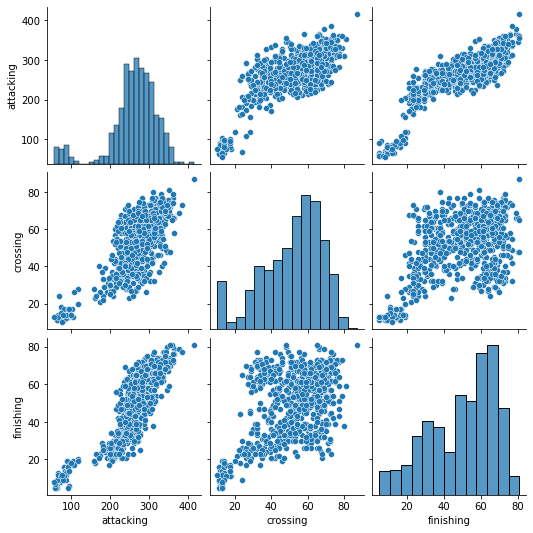

In [47]:
sns.pairplot(data.dropna().select_dtypes(exclude=object)[['attacking', 'crossing', 'finishing']])

In [7]:
import pickle

a = {'hello': 'world'}

In [28]:
with open('filename.pickle', 'wb') as handle:
    pickle.dump(a, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [29]:
with open('filename.pickle', 'rb') as handle:
    b = pickle.load(handle)

In [11]:
print(a == b)

True
